# AAI-500_Online_Retail_Data_Analysis

Names: Arifa Kokab, Andrew Roehr, Laxmi Sulakshana Rapolu 


**OVERVIEW**

**Dataset**

Online retail data set, which is a public data set that can be used for various data analysis and machine learning tasks. The data set contains information about the products, customers, and transactions of a UK-based online retailer that specializes in selling unique gifts for different occasions. The data set covers a period of one year, from December 2010 to December 2011, and includes 541,909 records of 6 variables, such as invoice number, stock code, description, quantity, invoice date, unit price, customer ID, and country. The data set can be used to explore the patterns and trends of online shopping behavior, such as customer segmentation, product recommendation, market basket analysis, and sales forecasting. The data set was donated by Daqing Chen, Sai Laing Sain, and Kun Guo from the University of East Anglia, and it is available at the UCI Machine Learning Repository. 

Dataset URL: https://archive.ics.uci.edu/dataset/352/online+retail

### Packages

Install packages before importing required packages if necessary <br/>
pip install numpy <br/>
pip install pandas <br/>
pip install matplotlib <br/>
pip install seaborn <br/>
pip install plotly <br/>
pip install scikit-learn <br/>
pip install ucimlrepo <br/>

In [1]:
# import necessary packages
from ucimlrepo import fetch_ucirepo 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from scipy import stats
from scipy.stats import shapiro
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

# EDA exploratory_data_analysis

### Data Cleaning

**Fetch and view data**

In [2]:
# fetch dataset 
online_retail = fetch_ucirepo(id=352) 
  
# data (as pandas dataframes) 
X = online_retail.data.features 
y = online_retail.data.targets

# print the first 5 rows of the dataframe
X.head()

,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom
1,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
2,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 8:26,2.75,17850.0,United Kingdom
3,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
4,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 8:26,3.39,17850.0,United Kingdom


**Review data and remove rows with missing values**

In [3]:
# view the information of the dataframe for missing rows
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 6 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Description  540455 non-null  object 
 1   Quantity     541909 non-null  int64  
 2   InvoiceDate  541909 non-null  object 
 3   UnitPrice    541909 non-null  float64
 4   CustomerID   406829 non-null  float64
 5   Country      541909 non-null  object 
dtypes: float64(2), int64(1), object(3)
memory usage: 24.8+ MB


In [4]:
# removing missing data rows
df_filtered_quantity = X[X['Quantity'].notnull()].copy()
df_filtered_unitprice= df_filtered_quantity[df_filtered_quantity['UnitPrice'].notnull()].copy()
df_filtered_customerId= df_filtered_unitprice[df_filtered_unitprice['CustomerID'].notnull()].copy()
df_filtered_description= df_filtered_customerId[df_filtered_customerId['Description'].notnull()].copy()
df_filtered_country= df_filtered_description[df_filtered_description['Country'].notnull()].copy()
df_filtered_invoicedate= df_filtered_country[df_filtered_country['InvoiceDate'].notnull()].copy()

# copy filtered data to new dataframe
df_filtered2 = df_filtered_invoicedate.copy()

# view the information of the dataframe after removing missing rows
df_filtered2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 406829 entries, 0 to 541908
Data columns (total 6 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Description  406829 non-null  object 
 1   Quantity     406829 non-null  int64  
 2   InvoiceDate  406829 non-null  object 
 3   UnitPrice    406829 non-null  float64
 4   CustomerID   406829 non-null  float64
 5   Country      406829 non-null  object 
dtypes: float64(2), int64(1), object(3)
memory usage: 21.7+ MB


In [5]:
# assigning Data Type to each variable
df_filtered2['Quantity'] = df_filtered2['Quantity'].astype(int)
df_filtered2['UnitPrice'] = df_filtered2['UnitPrice'].astype(float)
df_filtered2['CustomerID'] = df_filtered2['CustomerID'].astype('category')
df_filtered2['Description'] = df_filtered2['Description'].astype('category')
df_filtered2['Country'] = df_filtered2['Country'].astype('category')
df_filtered2['InvoiceDate'] = pd.to_datetime(df_filtered2['InvoiceDate'])

In [6]:
# adding a new column to find the Total (Qty x Unit Price)
df_filtered2["Total"] = df_filtered2["Quantity"] * df_filtered2["UnitPrice"]

# view the first 5 rows of the dataframe after adding the new column
df_filtered2.head()

,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Total
0,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,15.30
1,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34
2,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,22.00
3,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34
4,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34


In [7]:
# view data types of the dataframe
print(df_filtered2.dtypes)

Description          category
Quantity                int64
InvoiceDate    datetime64[ns]
UnitPrice             float64
CustomerID           category
Country              category
Total                 float64
dtype: object


### Descriptive Statistics

In [8]:
# summary statistics of numerical Columns
print('Total Value - Summary Statistics:')
print(df_filtered2["Total"].describe())
print("\nQuantity - Summary Statistics:")
print(df_filtered2['Quantity'].describe())
print('\nUnit Price - Summary Statistics:')
print(df_filtered2['UnitPrice'].describe())

Total Value - Summary Statistics:
count    406829.000000
mean         20.401854
std         427.591718
min     -168469.600000
25%           4.200000
50%          11.100000
75%          19.500000
max      168469.600000
Name: Total, dtype: float64

Quantity - Summary Statistics:
count    406829.000000
mean         12.061303
std         248.693370
min      -80995.000000
25%           2.000000
50%           5.000000
75%          12.000000
max       80995.000000
Name: Quantity, dtype: float64

Unit Price - Summary Statistics:
count    406829.000000
mean          3.460471
std          69.315162
min           0.000000
25%           1.250000
50%           1.950000
75%           3.750000
max       38970.000000
Name: UnitPrice, dtype: float64


In [9]:
# count for categorical columns
print('Count of Unique Values for Categorical Columns')
print(df_filtered2[['Country', 'CustomerID', 'Description']].nunique())

Count of Unique Values for Categorical Columns
Country          37
CustomerID     4372
Description    3896
dtype: int64


In [10]:
# top 10 countries with the highest number of transactions
df_filtered2[['Country']].value_counts().head(10)

Country       
United Kingdom    361878
Germany             9495
France              8491
EIRE                7485
Spain               2533
Netherlands         2371
Belgium             2069
Switzerland         1877
Portugal            1480
Australia           1259
Name: count, dtype: int64

In [11]:
# top 10 customer ids with the highest number of transactions
df_filtered2['CustomerID'].value_counts().head(10)

CustomerID
17841.0    7983
14911.0    5903
14096.0    5128
12748.0    4642
14606.0    2782
15311.0    2491
14646.0    2085
13089.0    1857
13263.0    1677
14298.0    1640
Name: count, dtype: int64

In [12]:
# top 10 products with the highest number of transactions
df_filtered2['Description'].value_counts().head(10)

Description
WHITE HANGING HEART T-LIGHT HOLDER    2070
REGENCY CAKESTAND 3 TIER              1905
JUMBO BAG RED RETROSPOT               1662
ASSORTED COLOUR BIRD ORNAMENT         1418
PARTY BUNTING                         1416
LUNCH BAG RED RETROSPOT               1358
SET OF 3 CAKE TINS PANTRY DESIGN      1232
POSTAGE                               1196
LUNCH BAG  BLACK SKULL.               1126
PACK OF 72 RETROSPOT CAKE CASES       1080
Name: count, dtype: int64

In [13]:
# customer analysis
customer_info = df_filtered2.groupby('CustomerID').agg({'Total':['count','sum']})
customer_info.columns = ['purchase_count','total_spending']
print('Customer Analysis:')
print(customer_info.sort_values(by='total_spending',ascending=False).head())

Customer Analysis:
            purchase_count  total_spending
CustomerID                                
14646.0               2085       279489.02
18102.0                433       256438.49
17450.0                351       187482.17
14911.0               5903       132572.62
12415.0                778       123725.45


/var/folders/zm/ljxd_tvn6xgb8l3zfbrtq2k80000gn/T/ipykernel_2629/4219944961.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  customer_info = df_filtered2.groupby('CustomerID').agg({'Total':['count','sum']})


In [14]:
# country analysis
country_info = df_filtered2.groupby('Country').agg({'Total':['count','sum']})
country_info.columns = ['purchase_count','total_spending']
print('Country Analysis:')
print(country_info.sort_values(by='total_spending',ascending=False).head())

Country Analysis:
                purchase_count  total_spending
Country                                       
United Kingdom          361878     6767873.394
Netherlands               2371      284661.540
EIRE                      7485      250285.220
Germany                   9495      221698.210
France                    8491      196712.840


/var/folders/zm/ljxd_tvn6xgb8l3zfbrtq2k80000gn/T/ipykernel_2629/4004385167.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  country_info = df_filtered2.groupby('Country').agg({'Total':['count','sum']})


**Plot Graphs**

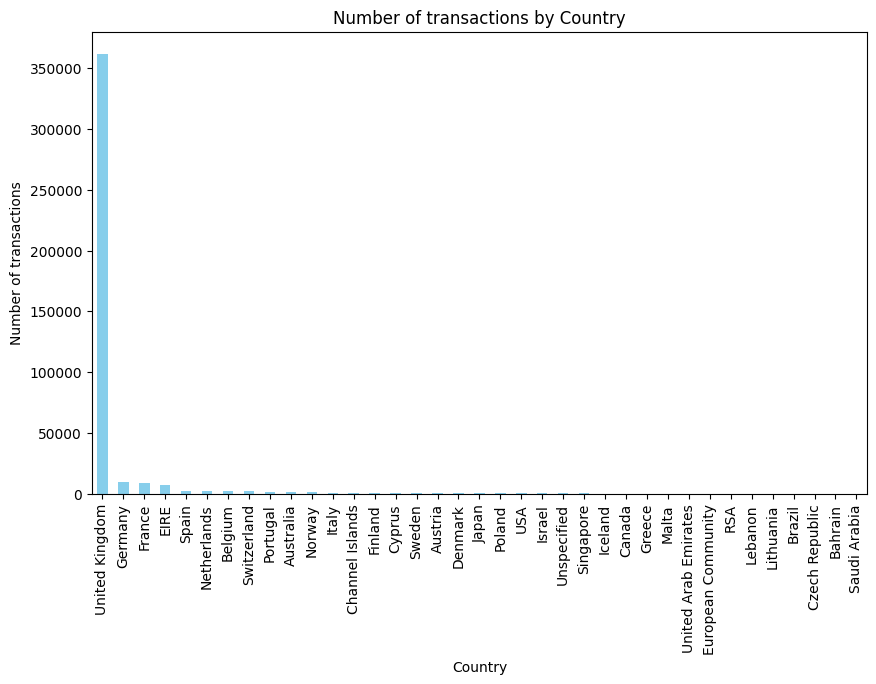

In [15]:
# bar graph for number of transactions by Country
df_filtered2['Country'].value_counts().plot(kind='bar', figsize=(10, 6), color='skyblue')

# add title and labels
plt.title('Number of transactions by Country')
plt.xlabel('Country')
plt.ylabel('Number of transactions')

# show the plot
plt.show()

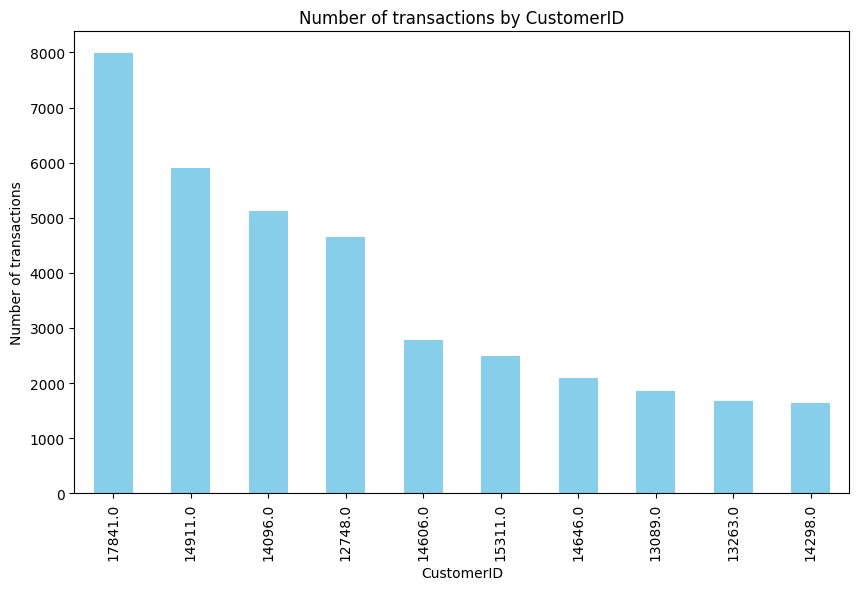

In [16]:
# bar graph for number of transactions by CustomerID (top 10)
df_filtered2['CustomerID'].value_counts().head(10).plot(kind='bar', figsize=(10, 6), color='skyblue')

# add title and labels
plt.title('Number of transactions by CustomerID')
plt.xlabel('CustomerID')
plt.ylabel('Number of transactions')

# show the plot
plt.show()

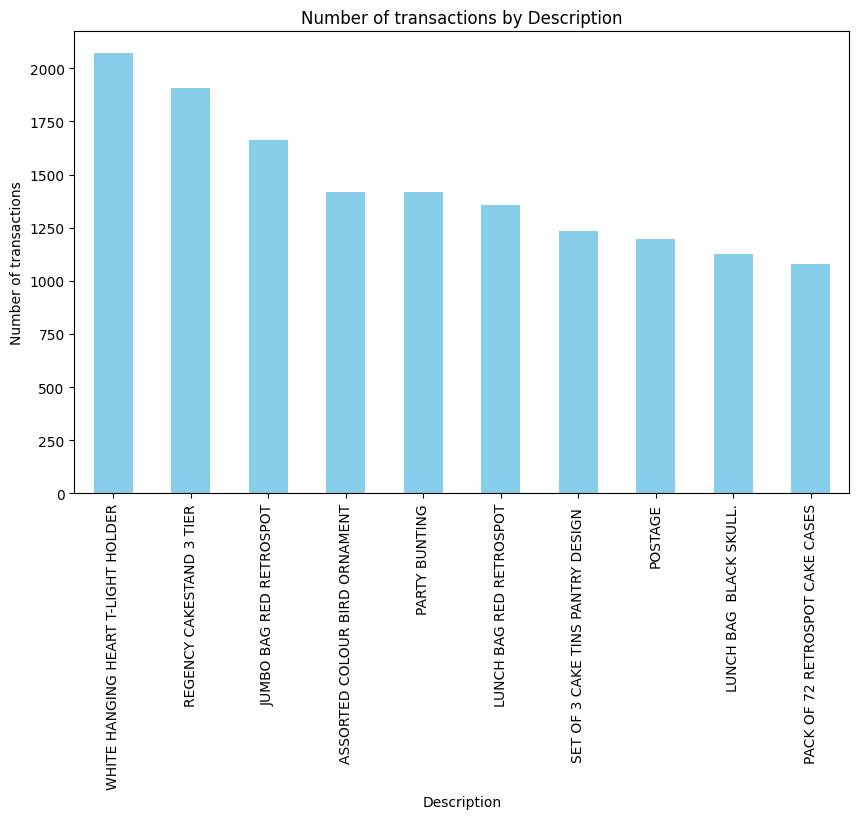

In [17]:
# bar graph for number of transactions by CustomerID (top 10)
df_filtered2['Description'].value_counts().head(10).plot(kind='bar', figsize=(10, 6), color='skyblue')

# add title and labels
plt.title('Number of transactions by Description')
plt.xlabel('Description')
plt.ylabel('Number of transactions')

# show the plot
plt.show()

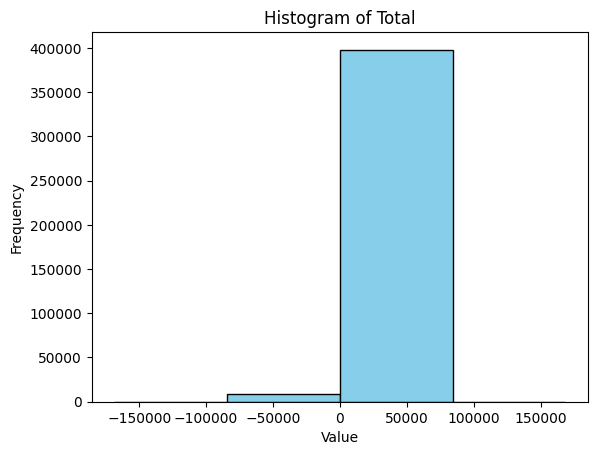

In [18]:
# histogram of total
plt.hist(df_filtered2['Total'], bins=4, color='skyblue', edgecolor='black')
plt.title('Histogram of Total')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.show()

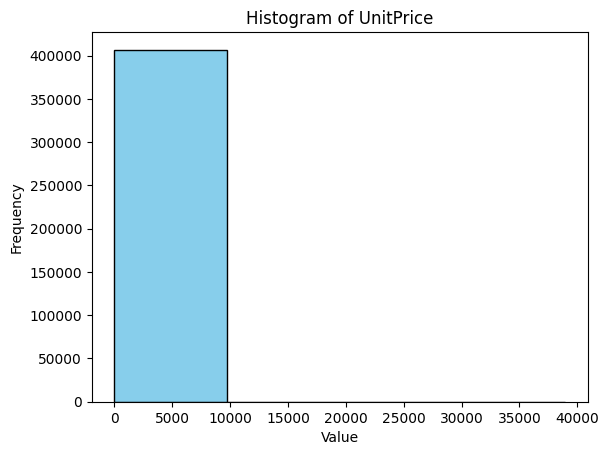

In [19]:
# histogram of unit price
plt.hist(df_filtered2['UnitPrice'], bins=4, color='skyblue', edgecolor='black')
plt.title('Histogram of UnitPrice')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.show()

In [20]:
# scatter plot of Quantity vs Total by Country
fig = px.scatter(df_filtered2, x='Quantity', y='Total', color='Country')
fig.show()

In [21]:
# scatter plot of Quantity vs Total by CustomerID
fig = px.scatter(df_filtered2, x='Quantity', y='Total', color='CustomerID')
fig.show()

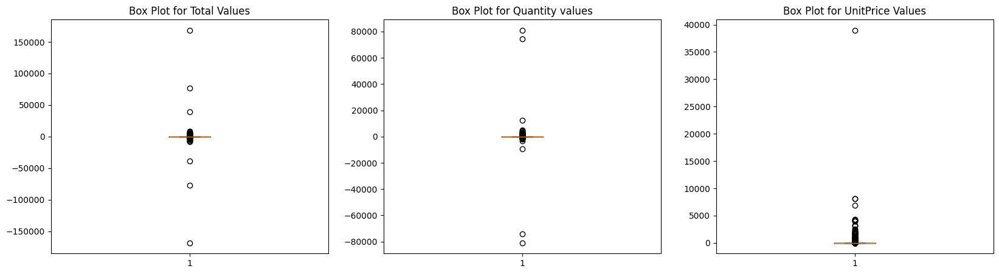

In [22]:
# creating subplots to show the box plot for Total, Quantity and Unit Price
fig, axes = plt.subplots(1, 3, figsize=(20, 5))

# creating box plot for Total values
axes[0].boxplot(df_filtered2['Total'])
axes[0].set_title('Box Plot for Total Values')

# creating box plot for Quantity values
axes[1].boxplot(df_filtered2['Quantity'])
axes[1].set_title('Box Plot for Quantity values')

# creating box plot for UnitPrice values
axes[2].boxplot(df_filtered2['UnitPrice'])
axes[2].set_title('Box Plot for UnitPrice Values')

# show the plots
plt.show()

### Inferential Statistics

**Ststistic Tests for Total Values**

In [23]:
# summary statistics of numerical Columns
print('Total Value - Summary Statistics:')
print(df_filtered2["Total"].describe())

Total Value - Summary Statistics:
count    406829.000000
mean         20.401854
std         427.591718
min     -168469.600000
25%           4.200000
50%          11.100000
75%          19.500000
max      168469.600000
Name: Total, dtype: float64


From Total value statistics, the large standard deviation (427.6) relative to the mean (20.40), it might be worth checking if the ‘Total’ data follows a normal distribution

In [24]:
# Shapiro-Wilk test
stat, p = shapiro(df_filtered2["Total"])
print('Statistics=%.3f, p=%.3f' % (stat, p))

# interpret
alpha = 0.05
if p > alpha:
    print('Sample looks Gaussian (fail to reject H0)')
else:
    print('Sample does not look Gaussian (reject H0)')

Statistics=0.008, p=0.000
Sample does not look Gaussian (reject H0)


/opt/homebrew/lib/python3.11/site-packages/scipy/stats/_morestats.py:1882: UserWarning:

p-value may not be accurate for N > 5000.



From Total value statistics, the minimum (-168469.6) and maximum (168469.6) values suggest the presence of outliers. The z-score measures how many standard deviations a data point is away from the mean. Interquartile Range (IQR) helps determining outliers. <br/>
Identified from below code 373649 outliers.

Z-scores for Total:
0        -0.011932
1        -0.000145
2         0.003738
3        -0.000145
4        -0.000145
            ...   
541904   -0.023859
541905   -0.018246
541906   -0.008891
541907   -0.008891
541908   -0.012984
Name: Total, Length: 406829, dtype: float64

Outliers count:  373649

Outliers:                                  Description  Quantity         InvoiceDate  \
0        WHITE HANGING HEART T-LIGHT HOLDER         6 2010-12-01 08:26:00   
1                       WHITE METAL LANTERN         6 2010-12-01 08:26:00   
2            CREAM CUPID HEARTS COAT HANGER         8 2010-12-01 08:26:00   
3       KNITTED UNION FLAG HOT WATER BOTTLE         6 2010-12-01 08:26:00   
4            RED WOOLLY HOTTIE WHITE HEART.         6 2010-12-01 08:26:00   
...                                     ...       ...                 ...   
541904          PACK OF 20 SPACEBOY NAPKINS        12 2011-12-09 12:50:00   
541905         CHILDREN'S APRON DOLLY GIRL          6 2011-12-09 12:50:00 

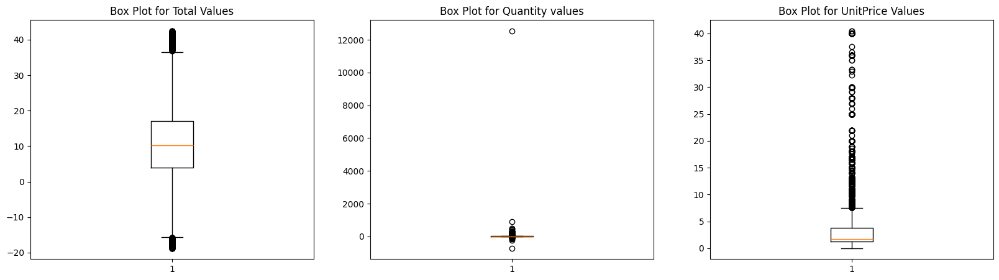

In [25]:
# calculate the z-scores
zscores = stats.zscore(df_filtered2["Total"])

# print the z-scores
print('Z-scores for Total:')
print(zscores)

# calculating IQR for 'Total'
Q1 = df_filtered2['Total'].quantile(0.25)
Q3 = df_filtered2['Total'].quantile(0.75)
IQR = Q3 - Q1

# defining bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# filtering out outliers
df_no_outliers = df_filtered2[(df_filtered2['Total'] >= lower_bound) & (df_filtered2['Total'] <= upper_bound)]

print('\nOutliers count: ', len(df_no_outliers))
print('\nOutliers: ', df_no_outliers)

# creating subplots to show the box plot for Total, Quantity and Unit Price
fig, axes = plt.subplots(1, 3, figsize=(20, 5))

# creating box plot for Total values
axes[0].boxplot(df_no_outliers['Total'])
axes[0].set_title('Box Plot for Total Values')

# creating box plot for Quantity values
axes[1].boxplot(df_no_outliers['Quantity'])
axes[1].set_title('Box Plot for Quantity values')

# creating box plot for UnitPrice values
axes[2].boxplot(df_no_outliers['UnitPrice'])
axes[2].set_title('Box Plot for UnitPrice Values')

# show the plots
plt.show()

Let's see if the data is distributed normally after removing outliers

In [26]:
# Shapiro-Wilk test
stat, p = shapiro(df_no_outliers["Total"])
print('Statistics=%.3f, p=%.3f' % (stat, p))

# interpret
alpha = 0.05
if p > alpha:
    print('Sample looks Gaussian (fail to reject H0)')
else:
    print('Sample does not look Gaussian (reject H0)')

Statistics=0.945, p=0.000
Sample does not look Gaussian (reject H0)


/opt/homebrew/lib/python3.11/site-packages/scipy/stats/_morestats.py:1882: UserWarning:

p-value may not be accurate for N > 5000.



**Note:** Since there is no other data to compare with, we are not performing hypothesis testing (e.g., t-test or ANOVA) or correlation analysis (e.g., Pearson or Spearman correlation)


# Model Selection & Analysis

## Model Selection and Analysis with outliers

**Staging Variables for Model Selection & Analysis**

In [27]:
X = df_filtered2[['Quantity', 'UnitPrice']]  # Predictor variables
y = df_filtered2['Total']  # Target variable

# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### Linear Regression Model
**Initialization**<br/>
The Linear Regression model was selected for its straightforward interpretability and the anticipated direct correlation between the input features and the target variable, which aligns well with typical patterns observed in retail sales data.

In [28]:
# Initializing and fitting the Linear Regression model
model_lr = LinearRegression()
model_lr.fit(X_train, y_train)

predictions = model_lr.predict(X_test)

**Model Analysis**

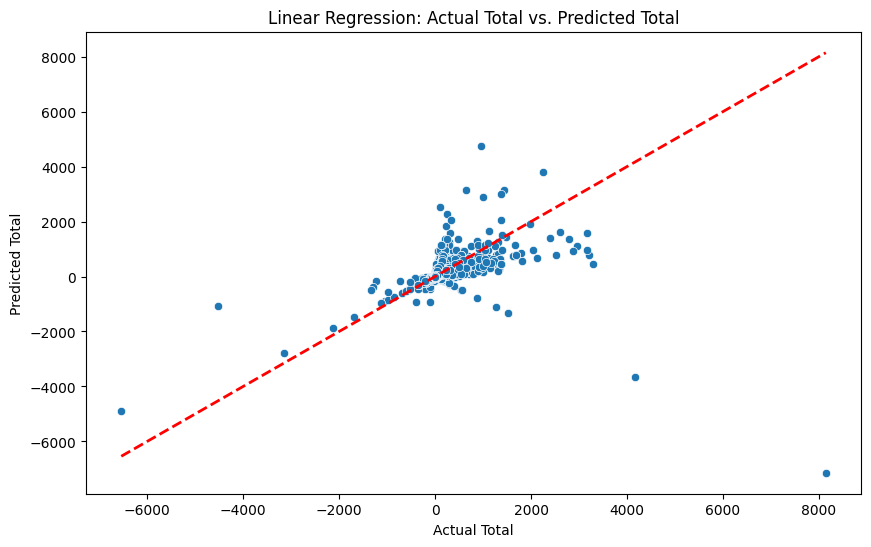

Mean Absolute Error (MAE): 15.92
Mean Squared Error (MSE): 6875.82
Root Mean Squared Error (RMSE): 82.92
R-squared Score: -0.08


In [29]:
# Actual vs Predicted scatter plot for Linear Regression
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=predictions)
plt.title('Linear Regression: Actual Total vs. Predicted Total')
plt.xlabel('Actual Total')
plt.ylabel('Predicted Total')
# Drawing a line for perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, linestyle='--')
plt.show()

# Calculating performance metrics
mae = mean_absolute_error(y_test, predictions)
mse = mean_squared_error(y_test, predictions)
rmse = np.sqrt(mse) # Root Mean Squared Error
r2 = r2_score(y_test, predictions)

print(f"Mean Absolute Error (MAE): {mae:.2f}")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse:.2f}")
print(f"R-squared Score: {r2:.2f}")

**Interpretation**<br/>
The Linear Regression model demonstrates poor predictive ability with an R-squared score of -0.08, indicating that the model fails to account for the variance in the total sales and, in fact, performs worse than a simple horizontal line representing the mean of the actual values. The high Root Mean Squared Error (RMSE) of 82.92 further suggests that there are substantial discrepancies between the predicted and actual values.

### Decision Tree Model
**Initialization**<br/>
The Decision Tree model was selected to address the shortcomings of in the Linear Regression Model, since it's generated values revealed its inability to predict the data set at all. Decision Tree's hierarchical decision-making capability provides a nuanced understanding of the diverse factors influencing retail sales, effectively capturing the intricacies that a linear approach may overlook.

In [30]:
# Initializing and fitting the Decision Tree model
model_dt = DecisionTreeRegressor(random_state=42)
model_dt.fit(X_train, y_train)

predictions_dt = model_dt.predict(X_test)

**Model Analysis**

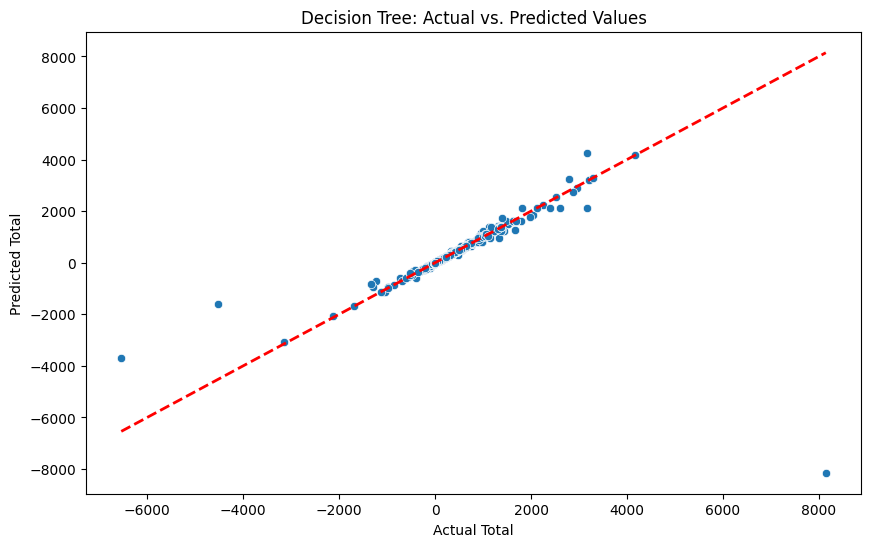

Decision Tree Mean Absolute Error (MAE): 0.47
Decision Tree Mean Squared Error (MSE): 3524.25
Decision Tree Root Mean Squared Error (RMSE): 59.37
Decision Tree R-squared Score: 0.45


In [31]:
# Actual vs Predicted scatter plot for Decision Tree
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=predictions_dt)
plt.title('Decision Tree: Actual vs. Predicted Values')
plt.xlabel('Actual Total')
plt.ylabel('Predicted Total')
# Drawing a line for perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, linestyle='--')
plt.show()

# Calculating performance metrics for Decision Tree
mae_dt = mean_absolute_error(y_test, predictions_dt)
mse_dt = mean_squared_error(y_test, predictions_dt)
rmse_dt = np.sqrt(mse_dt)  # Root Mean Squared Error
r2_dt = r2_score(y_test, predictions_dt)

print(f"Decision Tree Mean Absolute Error (MAE): {mae_dt:.2f}")
print(f"Decision Tree Mean Squared Error (MSE): {mse_dt:.2f}")
print(f"Decision Tree Root Mean Squared Error (RMSE): {rmse_dt:.2f}")
print(f"Decision Tree R-squared Score: {r2_dt:.2f}")


**Interpretation**<br/>
The Decision Tree model has a low R-squared score of 0.45, indicating it explains less than half of the variance in the data and may not be suitable for predicting sales effectively. The model's relatively high Mean Squared Error (MSE) of 3524.25 and Root Mean Squared Error suggest that its predictions deviate significantly from the actual sales figures.

### Random Forest Model
**Intialization**<br/>
The Random Forest model was seleceted to overcome the Decision Tree's limitations, as evidenced by its lower R-squared value and higher errors, which suggest a potential overfit to the training data. Random Forests aggregate multiple trees to improve prediction accuracy and generalization to unseen data, aiming to rectify the single Decision Tree's shortcomings.

In [32]:
# Initializing and fitting the Random Forest Model
model_rf = RandomForestRegressor(n_estimators=100, random_state=42)
model_rf.fit(X_train, y_train)

predictions_rf = model_rf.predict(X_test)

**Model Analysis**

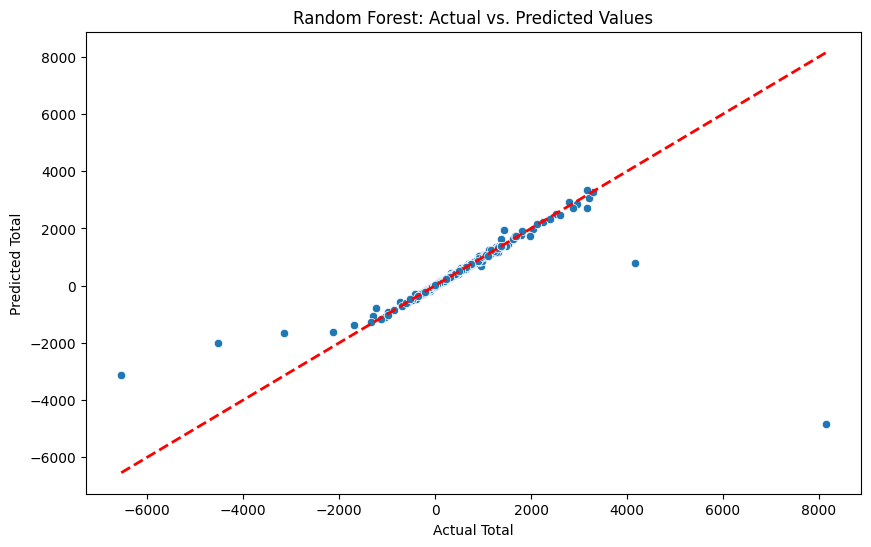

Random Forest Mean Absolute Error (MAE): 0.42
Random Forest Mean Squared Error (MSE): 2479.40
Random Forest Root Mean Squared Error (RMSE): 49.79
Random Forest R-squared Score: 0.61


In [33]:
# Actual vs Predicted scatter plot for Random Forest Model
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=predictions_rf)
plt.title('Random Forest: Actual vs. Predicted Values')
plt.xlabel('Actual Total')
plt.ylabel('Predicted Total')
# Drawing a line for perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, linestyle='--')
plt.show()

# Calculating performance metrics for Random Forest Model
mae_rf = mean_absolute_error(y_test, predictions_rf)
mse_rf = mean_squared_error(y_test, predictions_rf)
rmse_rf = np.sqrt(mse_rf)  # Root Mean Squared Error
r2_rf = r2_score(y_test, predictions_rf)

print(f"Random Forest Mean Absolute Error (MAE): {mae_rf:.2f}")
print(f"Random Forest Mean Squared Error (MSE): {mse_rf:.2f}")
print(f"Random Forest Root Mean Squared Error (RMSE): {rmse_rf:.2f}")
print(f"Random Forest R-squared Score: {r2_rf:.2f}")

**Interpretation**<br/>
The Random Forest model shows a moderate fit with an R-squared score of 0.61, indicating it explains about 61% of the variance in sales data. The Mean Squared Error (MSE) and Root Mean Squared Error (RMSE) values of 2479.40 and 49.79, respectively, suggest that while predictions are closer to actual values than the previous models, there is still a notable error margin.

## Model Selection and Analysis without outliers
Outliers can have a significant impact on the performance of a machine learning model. It is important to note that removing outliers should be done with caution. Outliers can sometimes provide valuable information about the data and the underlying process that generated it. Blindly removing outliers without understanding their cause might lead to misleading results. It’s always a good idea to investigate the source of outliers and consider the implications of removing them.

**Staging Variables for Model Selection & Analysis without outliers**

In [34]:
# Restaging
X_no_outliers = df_no_outliers[['Quantity', 'UnitPrice']] # Predictor variables w/o outliers
y_no_outliers = df_no_outliers['Total'] # Target variable w/o outliers

# Splitting the data into training and testing sets without outliers
X_train, X_test, y_train, y_test = train_test_split(X_no_outliers, y_no_outliers, test_size=0.2, random_state=42)

### Linear Regression Model Withoout Outliers
**Initialization**<br/>
To view the effect of outliers on the metrics

In [35]:
# Initializing and fitting the Linear Regression model
model_lr = LinearRegression()
model_lr.fit(X_train, y_train)

predictions = model_lr.predict(X_test)

**Model Analysis**

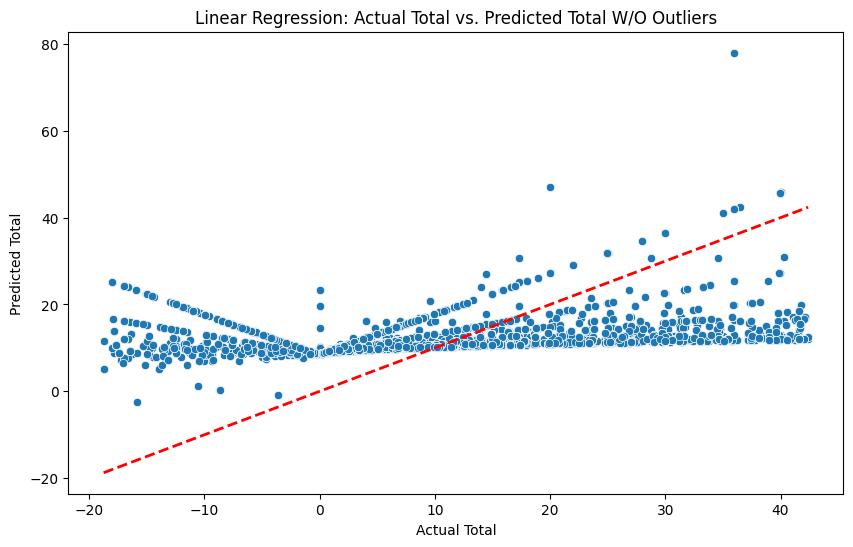

Mean Absolute Error (MAE): 6.88
Mean Squared Error (MSE): 76.13
Root Mean Squared Error (RMSE): 8.73
R-squared Score: 0.14


In [36]:
# Actual vs Predicted scatter plot for Linear Regression
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=predictions)
plt.title('Linear Regression: Actual Total vs. Predicted Total W/O Outliers')
plt.xlabel('Actual Total')
plt.ylabel('Predicted Total')
# Drawing a line for perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, linestyle='--')
plt.show()

# Calculating performance metrics
mae = mean_absolute_error(y_test, predictions)
mse = mean_squared_error(y_test, predictions)
rmse = np.sqrt(mse) # Root Mean Squared Error
r2 = r2_score(y_test, predictions)

print(f"Mean Absolute Error (MAE): {mae:.2f}")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse:.2f}")
print(f"R-squared Score: {r2:.2f}")

**Interpretations**<br/>
When outliers are removed, the model might fit the majority of the data better, but it might also lose some of its ability to generalize, leading to a lower R-squared score.<br/>
Also, these error metrics can decrease significantly, indicating a better fit to the data.<br/>
Many models, including Linear Regression, assume that the data is normally distributed. Outliers can violate this assumption, leading to a poor model fit. But data is not normally distributed, even after removing outliers, the assumptions of Linear Regression might still be violated, which can lead to a poor model fit. <br/>
In such cases, Transformation of variables (logarithmic, square root, or inverse transformations) is considered, to make the distribution more normal or a good alternative when data is not normally distributed is to include Decision Trees, Random Forests etc.

### Decision Tree Model Withoout Outliers
**Initialization**<br/>

In [37]:
# Initializing and fitting the Decision Tree model
model_dt = DecisionTreeRegressor(random_state=42)
model_dt.fit(X_train, y_train)

predictions_dt = model_dt.predict(X_test)

**Model Analysis**

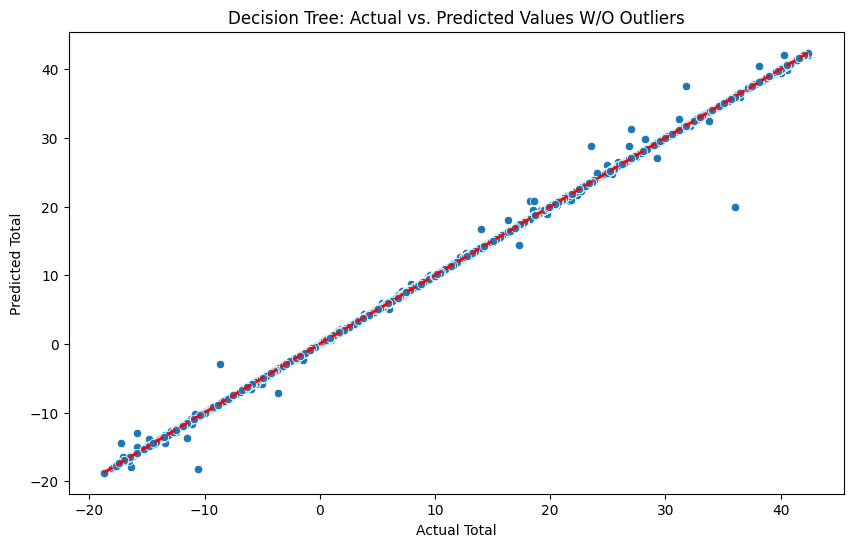

Decision Tree Mean Absolute Error (MAE): 0.00
Decision Tree Mean Squared Error (MSE): 0.01
Decision Tree Root Mean Squared Error (RMSE): 0.08
Decision Tree R-squared Score: 1.00


In [38]:
# Actual vs Predicted scatter plot for Decision Tree
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=predictions_dt)
plt.title('Decision Tree: Actual vs. Predicted Values W/O Outliers')
plt.xlabel('Actual Total')
plt.ylabel('Predicted Total')
# Drawing a line for perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, linestyle='--')
plt.show()

# Calculating performance metrics for Decision Tree
mae_dt = mean_absolute_error(y_test, predictions_dt)
mse_dt = mean_squared_error(y_test, predictions_dt)
rmse_dt = np.sqrt(mse_dt)  # Root Mean Squared Error
r2_dt = r2_score(y_test, predictions_dt)

print(f"Decision Tree Mean Absolute Error (MAE): {mae_dt:.2f}")
print(f"Decision Tree Mean Squared Error (MSE): {mse_dt:.2f}")
print(f"Decision Tree Root Mean Squared Error (RMSE): {rmse_dt:.2f}")
print(f"Decision Tree R-squared Score: {r2_dt:.2f}")

**Interpretations**<br/>
The decision tree model is perfect, as indicated by an MAE of 0.00 and an R-squared score of 1.00, meaning all predictions were exact. MSE and RMSE values are very low, indicating minimal error between predicted and actual values. The model performs perfectly without outliers but struggles with them, indicating that it might be sensitive to extreme values.

### Random Forest Model & Analysis Withoout Outliers
**Initialization**<br/>
The Random Forest Model was selected for fine tuning (i.e. rerunning without outliers) since it had the lowest errors and it's r-squared value most likely suffered due to the major outliers existing on the opposite side of the spectrum.

In [39]:
# Initializing and fitting the Random Forest Model
model_rf = RandomForestRegressor(n_estimators=100, random_state=42)
model_rf.fit(X_train, y_train)

predictions_rf = model_rf.predict(X_test)

**Model Analysis**

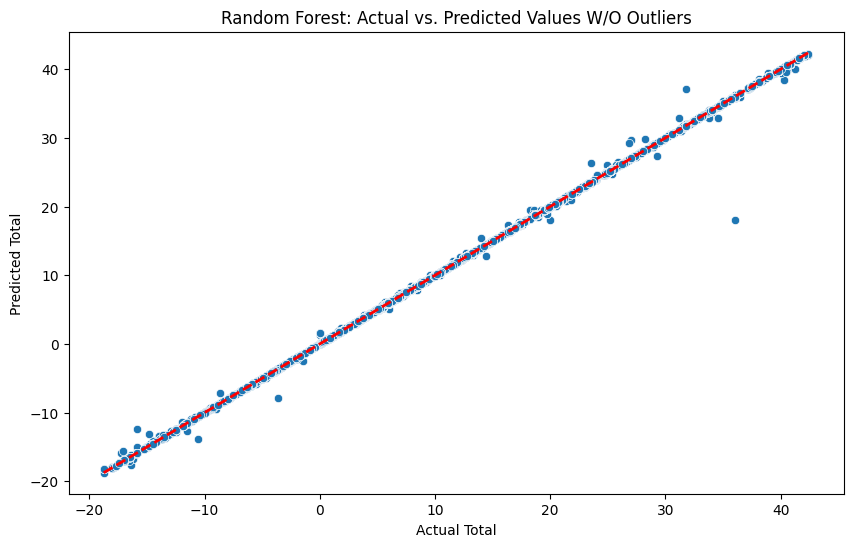

Random Forest Mean Absolute Error (MAE): 0.00
Random Forest Mean Squared Error (MSE): 0.01
Random Forest Root Mean Squared Error (RMSE): 0.08
Random Forest R-squared Score: 1.00


In [40]:
# Actual vs Predicted scatter plot for Random Forest Model
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=predictions_rf)
plt.title('Random Forest: Actual vs. Predicted Values W/O Outliers')
plt.xlabel('Actual Total')
plt.ylabel('Predicted Total')
# Drawing a line for perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, linestyle='--')
plt.show()

# Calculating performance metrics for Random Forest Model
mae_rf = mean_absolute_error(y_test, predictions_rf)
mse_rf = mean_squared_error(y_test, predictions_rf)
rmse_rf = np.sqrt(mse_rf)  # Root Mean Squared Error
r2_rf = r2_score(y_test, predictions_rf)

print(f"Random Forest Mean Absolute Error (MAE): {mae_rf:.2f}")
print(f"Random Forest Mean Squared Error (MSE): {mse_rf:.2f}")
print(f"Random Forest Root Mean Squared Error (RMSE): {rmse_rf:.2f}")
print(f"Random Forest R-squared Score: {r2_rf:.2f}")

The Random Forest model achieved an R-squared score of 1.00 and an RMSE of 0.08, which is a near perfect predictions on the test data. A bit too perfect, which could be a result of overfitting but seeing how only two outliers on the opposite ends of the spectrum was removed, it is most likely due the lack of diversity or the homogeneity of the data set. The outcome also demonstrates that for this dataset, the Decision Tree Model predicts just as well. 

# Conclusions

1. The sales data is highly variable with a large standard deviation of $427.59, and it does not follow a normal distribution. This could make it challenging to model and predict using standard statistical techniques that assume normality.
2. The presence of a significant number of outliers (373,649) in the data could be influencing the results of the models. These outliers could be due to large transactions, errors, or other anomalies.
3. The Linear Regression model with outliers couldn't predict at all, and it had the highest RMSE of 82.92, which indicates that there are significant discrepancies between the predicted and actual values for certain observations.
4. The Decision Tree model and the Random Forest model with outliers produced incrementally better results in predicting Total sales, with the Random Forest model being the most precise.
5. The models without outliers (Linear Regression, Decision Tree, and Random Forest) show varying degrees of performance. The Linear Regression model could only explain 14% of the variance, suggesting that it might be oversimplified or missing important features. On the other hand, the Decision Tree and Random Forest models achieve a perfect R-squared score of 1.00, which could be a sign of overfitting.
6. The overfitting in the Decision Tree and Random Forest models without outliers suggests that these models may not generalize well to new data. This is especially concerning given that they struggle with outliers, which are present in the dataset.<br/>
In summary, while some models show promising results, there are significant challenges due to the nature of the data and the presence of outliers. Further investigation and potentially more sophisticated modeling techniques may be required to improve the prediction accuracy.

# Predictions

1. Given the non-normal distribution of the data, traditional linear regression may not provide the best model for prediction. The presence of outliers can particularly impact the performance of linear regression. <br/>
2. More complex models, such as Decision Trees or Random Forests, might be better suited to handle the non-linear relationships and high variability in the data. <br/>
3. Given the high RMSE values for all models, it’s likely that there are complex, non-linear relationships in the data that these models are not fully capturing. <br/>
4. The Random Forest model, despite its limitations, might still be the best out of the three for this particular dataset due to its ability to handle complex, non-linear data.
Given the perfect scores of the Decision Tree and Random Forest models without outliers, it’s likely that these models are overfitting the data. This means they might not generalize well to new, unseen data.

# Suggestions

Here are some potential next steps for improving sales prediction models, since model development is an iterative process:
1. Consider using robust regression methods or non-parametric models that do not assume a normal distribution. More advanced machine learning models such as Gradient Boosting or Deep Learning models might be better at handling non-linear data and outliers.
2. Investigate the outliers in more detail. If they represent valid sales transactions, consider strategies for handling outliers in your models. If they are errors, consider removing or correcting them.
3. Creating new variables that capture important aspects of the data, or transforming existing variables (e.g., using a log transformation to reduce skewness).
4. Since the data is not normally distributed, consider using data transformation techniques to normalize it. This can help improve the performance of certain models.
5. Regularly retrain the models with new data to ensure they continue to perform well as new sales data comes in.
6. Perform hyperparameter tuning on the Random Forest, Decision Tree, and other models to potentially improve their performance.
7. Consider combining the predictions of multiple models, to improve prediction accuracy.
8. Consider using cross-validation techniques to better assess the performance of your models and guard against overfitting.